In [2]:
import numpy as np
from numpy.linalg import norm
from umap import UMAP
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
from tqdm import tqdm

from utils import encode_image
from utils import bt_embeddings

from PIL import Image
from IPython.display import display

c:\Users\User\anaconda3\envs\mm-rag\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
img1 = {
  'caption': 'Black Audi car on the road',
  'image_path' : './data/images/car_1.jpg'
}

img2 = {
    'caption': 'Blue Audi car',
    'image_path' : './data/images/car_2.jpg'
}

img3 = {
    'caption': 'Harley Davidson motorcycle on the road',
    'image_path' : './data/images/motorcycle_3.jpg'
}

img4 = {
    'caption': 'A motorcycle sits parked across from a herd of livestock',
    'image_path' : './data/images/motorcycle_1.jpg'
}

img5 = {
    'caption': 'Motorcycle on platform to be worked on in garage',
    'image_path' : './data/images/motorcycle_2.jpg'
}

img6 = {
    'caption': 'Cat lying on the ground',
    'image_path' : './data/images/cat_1.jpg'
}

img7 = {
    'caption': 'Cat playing on the grass',
    'image_path' : './data/images/cat_2.jpg'
}

img8 = {
    'caption': 'Black cat in the garden',
    'image_path' : './data/images/cat_3.jpg'
}

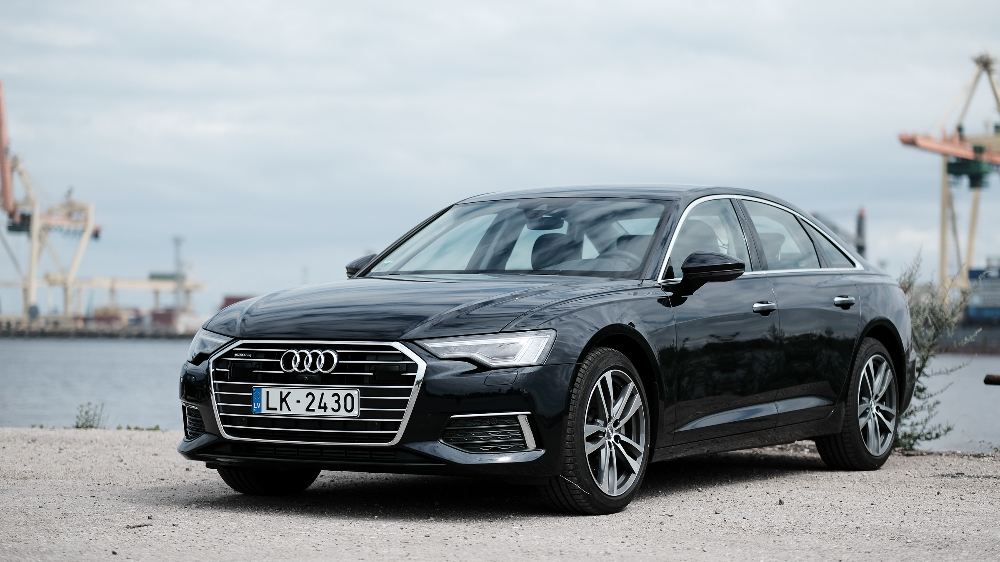

'Black Audi car on the road'

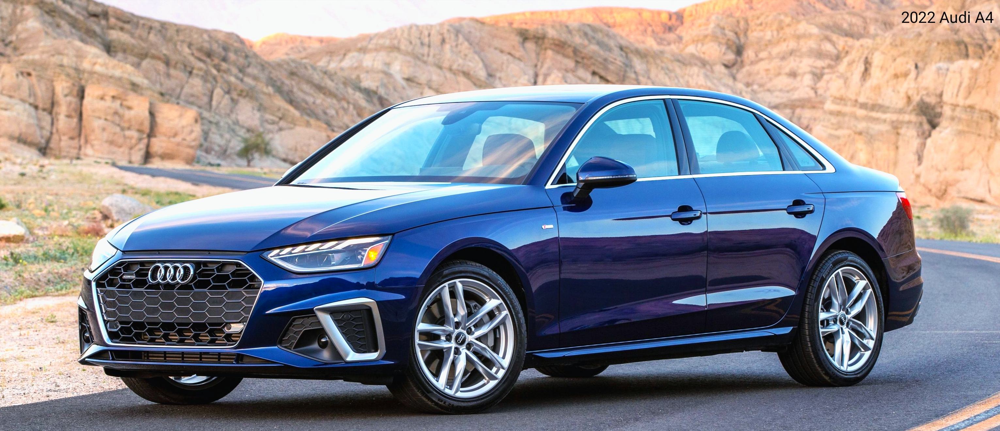

'Blue Audi car'

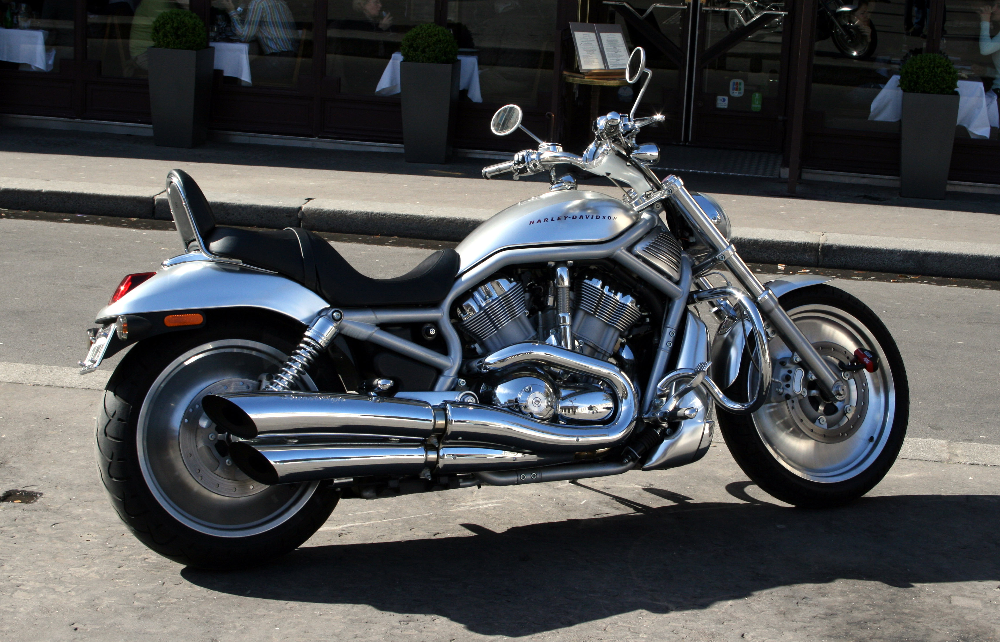

'Harley Davidson motorcycle on the road'

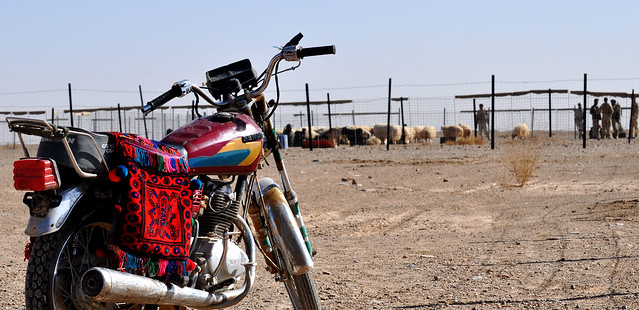

'A motorcycle sits parked across from a herd of livestock'

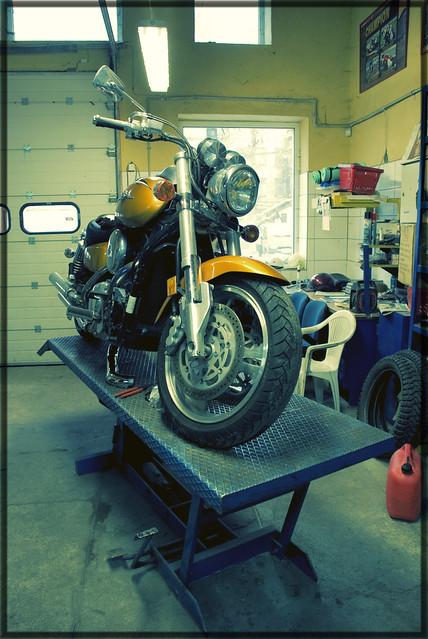

'Motorcycle on platform to be worked on in garage'

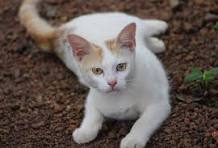

'Cat lying on the ground'

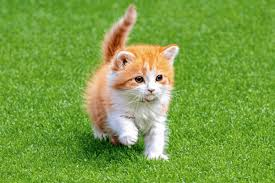

'Cat playing on the grass'

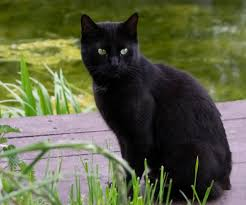

'Black cat in the garden'

In [4]:
image_text_pairs = [img1, img2, img3, img4, img5, img6, img7, img8]

for img in image_text_pairs:
    image = Image.open(img['image_path'])
    caption = img['caption']
    display(image)
    display(caption)

In [5]:
embeddings = []

for img in image_text_pairs:
    img_path = img['image_path']
    caption = img['caption']
    base64_img = encode_image(img_path)
    embedding = bt_embeddings(caption, base64_img)
    embeddings.append(embedding)

Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/

In [7]:
# Each image-text pair is now converted into multimodal 
# embedding vector which has dimensions of 512.

print(len(embeddings[0]))

512


In [8]:
def cosine_similarity(vec1, vec2):
    similarity = np.dot(vec1,vec2)/(norm(vec1)*norm(vec2))
    return similarity

In [11]:
ex1_embed = np.array(embeddings[0])
ex2_embed = np.array(embeddings[1])
ex3_embed = np.array(embeddings[6])
sim_ex1_ex2 = cosine_similarity(ex1_embed, ex2_embed)
sim_ex1_ex3 = cosine_similarity(ex1_embed, ex3_embed)

In [14]:
print("Cosine similarity between ex1_embeded and ex2_embeded is:")
display(sim_ex1_ex2)
print("Cosine similarity between ex1_embeded and ex3_embeded is:")
display(sim_ex1_ex3)

Cosine similarity between ex1_embeded and ex2_embeded is:


0.6728651524152298

Cosine similarity between ex1_embeded and ex3_embeded is:


0.09782777702947545

'Black Audi car on the road'

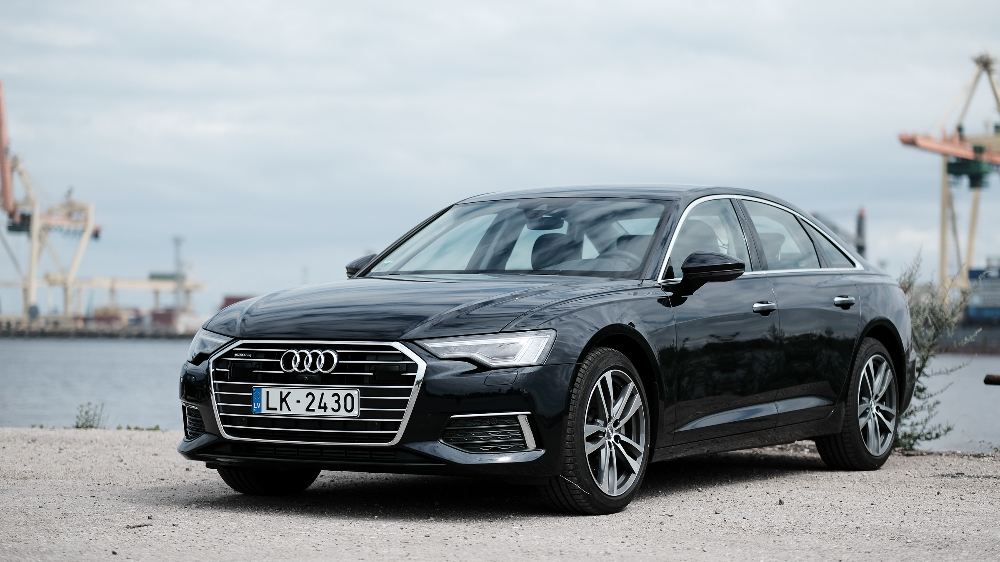

In [15]:
for img in image_text_pairs:
    img['pil_img'] = Image.open(img['image_path'])
# display an example of a cat image-text pair data
display(image_text_pairs[0]['caption'])
display(image_text_pairs[0]['pil_img'])

In [16]:
# compute BridgeTower embeddings for cat image-text pairs
embeddings = []
for img_txt_pair in tqdm(
                        image_text_pairs, 
                        total=len(image_text_pairs)
                    ):
    pil_img = img_txt_pair['pil_img']
    caption = img_txt_pair['caption']
    base64_img = encode_image(pil_img)
    embedding = bt_embeddings(caption, base64_img)
    embeddings.append(embedding)

  0%|          | 0/8 [00:00<?, ?it/s]Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
 12%|█▎        | 1/8 [00:07<00:52,  7.47s/it]Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
 25%|██▌       | 2/8 [00:14<00:44,  7.46s/it]Some weights of BridgeTowerForContrastiveLearning were not initialized from the model checkpoint at BridgeTower/bridgetower-large-itm-mlm-itc and are newly initialized: ['logit_scale']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions 

In [17]:
# function transforms high-dimension vectors to 2D vectors using UMAP
def dimensionality_reduction(embed_arr, label):
    X_scaled = MinMaxScaler().fit_transform(embed_arr)
    print(X_scaled)
    mapper = UMAP(n_components=2, metric="cosine").fit(X_scaled)
    df_emb = pd.DataFrame(mapper.embedding_, columns=["X", "Y"])
    df_emb["label"] = label
    print(df_emb)
    return df_emb

In [18]:
# prepare labels for the 3 examples
labels = ['car'] * 2 + ['motorcycle'] * 3 + ['cat'] * 3
print(labels)
# compute dimensionality reduction for the 3 examples
reduced_dim_emb = dimensionality_reduction(embeddings, labels)

['car', 'car', 'motorcycle', 'motorcycle', 'motorcycle', 'cat', 'cat', 'cat']
[[0.97386953 0.63602014 0.49097689 ... 0.71988723 0.56977391 0.10756057]
 [1.         1.         0.50038388 ... 0.61453804 0.8949492  0.20805794]
 [0.61941564 0.10987217 0.57802336 ... 1.         1.         0.        ]
 ...
 [0.         0.44430625 0.95808162 ... 0.35742333 0.         1.        ]
 [0.14560071 0.8832986  0.56734089 ... 0.23674478 0.01753487 0.41773386]
 [0.0577296  0.61222204 1.         ... 0.45325016 0.09169117 0.74951812]]


c:\Users\User\anaconda3\envs\mm-rag\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\User\anaconda3\envs\mm-rag\Lib\site-packages\umap\umap_.py:2462: UserWarning: n_neighbors is larger than the dataset size; truncating to X.shape[0] - 1
  warn(


           X         Y       label
0  16.551828 -6.960361         car
1  16.132902 -7.399345         car
2  16.990490 -8.073801  motorcycle
3  16.126326 -8.709382  motorcycle
4  16.896502 -8.980487  motorcycle
5  15.084145 -8.895538         cat
6  14.491947 -8.165805         cat
7  15.286174 -7.853850         cat


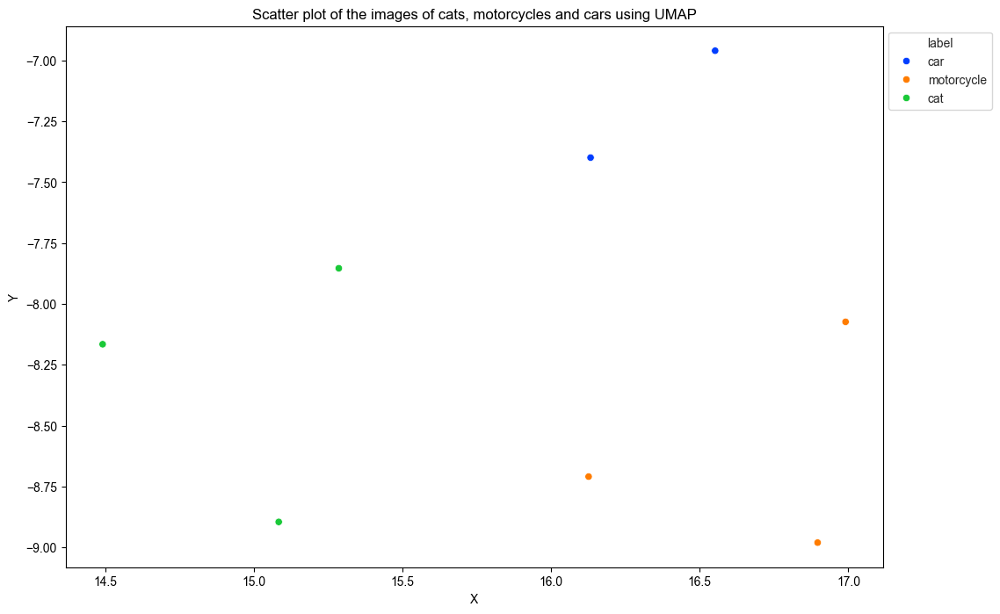

In [19]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the centroids against the cluster
fig, ax = plt.subplots(figsize=(12,8)) # Set figsize

sns.set_style("whitegrid", {'axes.grid' : False})
sns.scatterplot(data=reduced_dim_emb, 
                x=reduced_dim_emb['X'], 
                y=reduced_dim_emb['Y'], 
                hue='label', 
                palette='bright')
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.title('Scatter plot of the images of cats, motorcycles and cars using UMAP')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()

In [20]:
reduced_dim_emb

,X,Y,label
0,16.551828,-6.960361,car
1,16.132902,-7.399345,car
2,16.990490,-8.073801,motorcycle
3,16.126326,-8.709382,motorcycle
4,16.896502,-8.980487,motorcycle
5,15.084145,-8.895538,cat
6,14.491947,-8.165805,cat
7,15.286174,-7.853850,cat
